In [1]:
!pip install mlxtend

In [2]:
!pip install dataprep
#https://thecleverprogrammer.com/2021/02/08/customer-personality-analysis-with-python/

  Using cached SQLAlchemy-1.3.24-cp39-cp39-win_amd64.whl (1.2 MB)
  Attempting uninstall: sqlalchemy
    Found existing installation: SQLAlchemy 1.4.36
    Uninstalling SQLAlchemy-1.4.36:
      Successfully uninstalled SQLAlchemy-1.4.36


In [3]:
import numpy as np
import pandas as pd
import datetime
from datetime import date
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler, normalize
from sklearn import metrics
from sklearn.mixture import GaussianMixture
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
import warnings
warnings.filterwarnings('ignore')

In [286]:
data=pd.read_csv('https://raw.githubusercontent.com/amankharwal/Website-data/master/marketing_campaign.csv',header=0,sep=';')

In [275]:
data.dtypes

ID                       int64
Year_Birth               int64
Education               object
Marital_Status          object
Income                 float64
Kidhome                  int64
Teenhome                 int64
Dt_Customer             object
Recency                  int64
MntWines                 int64
MntFruits                int64
MntMeatProducts          int64
MntFishProducts          int64
MntSweetProducts         int64
MntGoldProds             int64
NumDealsPurchases        int64
NumWebPurchases          int64
NumCatalogPurchases      int64
NumStorePurchases        int64
NumWebVisitsMonth        int64
AcceptedCmp3             int64
AcceptedCmp4             int64
AcceptedCmp5             int64
AcceptedCmp1             int64
AcceptedCmp2             int64
Complain                 int64
Z_CostContact            int64
Z_Revenue                int64
Response                 int64
dtype: object

In [278]:
data[['Education','Marital_Status','Dt_Customer']] = data[['Education','Marital_Status','Dt_Customer']].astype(str)

In [279]:
data.dtypes

ID                       int64
Year_Birth               int64
Education               object
Marital_Status          object
Income                 float64
Kidhome                  int64
Teenhome                 int64
Dt_Customer             object
Recency                  int64
MntWines                 int64
MntFruits                int64
MntMeatProducts          int64
MntFishProducts          int64
MntSweetProducts         int64
MntGoldProds             int64
NumDealsPurchases        int64
NumWebPurchases          int64
NumCatalogPurchases      int64
NumStorePurchases        int64
NumWebVisitsMonth        int64
AcceptedCmp3             int64
AcceptedCmp4             int64
AcceptedCmp5             int64
AcceptedCmp1             int64
AcceptedCmp2             int64
Complain                 int64
Z_CostContact            int64
Z_Revenue                int64
Response                 int64
dtype: object

In [130]:
from dataprep.eda import plot, plot_correlation, create_report, plot_missing

TypeError: 'numpy._DTypeMeta' object is not subscriptable

  0%|                                                                                         | 0/1523 [00:00<…


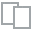
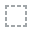
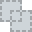
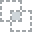
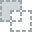
...
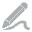
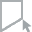
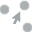
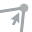
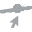

In [9]:
plot(data)

In [287]:
#Spending variable creation
data['Age']=2014-data['Year_Birth']

data['Spending']=data['MntWines']+data['MntFruits']+data['MntMeatProducts']+data['MntFishProducts']+data['MntSweetProducts']+data['MntGoldProds']
#Seniority variable creation
last_date = date(2014,10, 4)
data['Seniority']=pd.to_datetime(data['Dt_Customer'], dayfirst=True,format = '%Y-%m-%d')
data['Seniority'] = pd.to_numeric(data['Seniority'].dt.date.apply(lambda x: (last_date - x)).dt.days, downcast='integer')/30
data=data.rename(columns={'NumWebPurchases': "Web",'NumCatalogPurchases':'Catalog','NumStorePurchases':'Store'})
data['Marital_Status']=data['Marital_Status'].replace({'Divorced':'Alone','Single':'Alone','Married':'In couple','Together':'In couple','Absurd':'Alone','Widow':'Alone','YOLO':'Alone'})
data['Education']=data['Education'].replace({'Basic':'Undergraduate','2n Cycle':'Undergraduate','Graduation':'Postgraduate','Master':'Postgraduate','PhD':'Postgraduate'})

data['Children']=data['Kidhome']+data['Teenhome']
data['Has_child'] = np.where(data.Children> 0, 'Has child', 'No child')
data['Children'].replace({3: "3 children",2:'2 children',1:'1 child',0:"No child"},inplace=True)
data=data.rename(columns={'MntWines': "Wines",'MntFruits':'Fruits','MntMeatProducts':'Meat','MntFishProducts':'Fish','MntSweetProducts':'Sweets','MntGoldProds':'Gold'})


data=data[['Age','Education','Marital_Status','Income','Spending','Seniority','Has_child','Children','Wines','Fruits','Meat','Fish','Sweets','Gold']]
data.head()

,Age,Education,Marital_Status,Income,Spending,Seniority,Has_child,Children,Wines,Fruits,Meat,Fish,Sweets,Gold
0,57,Postgraduate,Alone,58138,1617,25,No child,No child,635,88,546,172,88,88
1,60,Postgraduate,Alone,46344,27,7,Has child,2 children,11,1,6,2,1,6
2,49,Postgraduate,In couple,71613,776,14,No child,No child,426,49,127,111,21,42
3,30,Postgraduate,In couple,26646,53,8,Has child,1 child,11,4,20,10,3,5
4,33,Postgraduate,In couple,58293,422,9,Has child,1 child,173,43,118,46,27,15


In [288]:
#remove the outliers and the missing values in the dataset:
data=data.dropna(subset=['Income'])
data=data[data['Income']<600000]

# Clustering
To take a look at the clustering of clients in the dataset, I’ll define the segments of the clients. Here we will use 4 equally weighted customer segments:
1. Stars: Old customers with high income and high spending nature.
2. Neet Attention: New customers with below-average income and low spending nature. 
3.High Potential: New customers with high income and high spending nature.
4.Leaky Bucket: Old customers with below-average income and a low spending nature.

In [289]:
scaler=StandardScaler()
dataset_temp=data[['Income','Seniority','Spending']]
X_std=scaler.fit_transform(dataset_temp)
X = normalize(X_std,norm='l2')

gmm=GaussianMixture(n_components=4, covariance_type='spherical',max_iter=2000, random_state=5).fit(X)
labels = gmm.predict(X)
dataset_temp['Cluster'] = labels
dataset_temp=dataset_temp.replace({0:'Stars',1:'Need attention',2:'High potential',3:'Leaky bucket'})
data = data.merge(dataset_temp.Cluster, left_index=True, right_index=True)

pd.options.display.float_format = "{:.0f}".format
summary=data[['Income','Spending','Seniority','Cluster']]
summary.set_index("Cluster", inplace = True)
summary=summary.groupby('Cluster').describe().transpose()
summary.head()

Cluster       High potential  Leaky bucket  Need attention  Stars
Income count             584           641             528    462
       mean            34757         37705           69542  73438
       std             12075         12397           12006  13753
       min              2447          1730           44802  49090
       25%             26489         28839           60880  65298

In [290]:
PLOT = go.Figure()
for C in list(data.Cluster.unique()):
    PLOT.add_trace(go.Scatter3d(x = data[data.Cluster == C]['Income'],
                                y = data[data.Cluster == C]['Seniority'],
                                z = data[data.Cluster == C]['Spending'],                        
                                mode = 'markers',marker_size = 6, marker_line_width = 1,
                                name = str(C)))
PLOT.update_traces(hovertemplate='Income: %{x} <br>Seniority: %{y} <br>Spending: %{z}')

PLOT.update_layout(width = 800, height = 800, autosize = True, showlegend = True,
                   scene = dict(xaxis=dict(title = 'Income', titlefont_color = 'black'),
                                yaxis=dict(title = 'Seniority', titlefont_color = 'black'),
                                zaxis=dict(title = 'Spending', titlefont_color = 'black')),
                   font = dict(family = "Gilroy", color  = 'black', size = 12))

# Data Preparation for Customer Personality Analysis
Now I will prepare the data for the Apriori algorithm. Here I will be defining three segments of the customers according to the age, income and seniority:

In [291]:
#Create Age segment
cut_labels_Age = ['Young', 'Adult', 'Mature', 'Senior']
cut_bins = [0, 30, 45, 65, 120]
data['Age_group'] = pd.cut(data['Age'], bins=cut_bins, labels=cut_labels_Age)
#Create Income segment
cut_labels_Income = ['Low income', 'Low to medium income', 'Medium to high income', 'High income']
data['Income_group'] = pd.qcut(data['Income'], q=4, labels=cut_labels_Income)
#Create Seniority segment
cut_labels_Seniority = ['New customers', 'Discovering customers', 'Experienced customers', 'Old customers']
data['Seniority_group'] = pd.qcut(data['Seniority'], q=4, labels=cut_labels_Seniority)
#data=data.drop(columns=['Age','Income','Seniority'])

In [292]:
cut_labels = ['Low consumer', 'Frequent consumer', 'Biggest consumer']
data['Wines_segment'] = pd.qcut(data['Wines'][data['Wines']>0],q=[0, .25, .75, 1], labels=cut_labels).astype("object")
data['Fruits_segment'] = pd.qcut(data['Fruits'][data['Fruits']>0],q=[0, .25, .75, 1], labels=cut_labels).astype("object")
data['Meat_segment'] = pd.qcut(data['Meat'][data['Meat']>0],q=[0, .25, .75, 1], labels=cut_labels).astype("object")
data['Fish_segment'] = pd.qcut(data['Fish'][data['Fish']>0],q=[0, .25, .75, 1], labels=cut_labels).astype("object")
data['Sweets_segment'] = pd.qcut(data['Sweets'][data['Sweets']>0],q=[0, .25, .75, 1], labels=cut_labels).astype("object")
data['Gold_segment'] = pd.qcut(data['Gold'][data['Gold']>0],q=[0, .25, .75, 1], labels=cut_labels).astype("object")
data.replace(np.nan, "Non consumer",inplace=True)
#data.drop(columns=['Spending','Wines','Fruits','Meat','Fish','Sweets','Gold'],inplace=True)
data = data.astype(object)

In [293]:
data.head()

,Age,Education,Marital_Status,Income,Spending,Seniority,Has_child,Children,Wines,Fruits,Meat,Fish,Sweets,Gold,Cluster,Age_group,Income_group,Seniority_group,Wines_segment,Fruits_segment,Meat_segment,Fish_segment,Sweets_segment,Gold_segment
0,57,Postgraduate,Alone,58138,1617,25,No child,No child,635,88,546,172,88,88,Need attention,Mature,Medium to high income,Old customers,Biggest consumer,Biggest consumer,Biggest consumer,Biggest consumer,Biggest consumer,Biggest consumer
1,60,Postgraduate,Alone,46344,27,7,Has child,2 children,11,1,6,2,1,6,Leaky bucket,Mature,Low to medium income,New customers,Low consumer,Low consumer,Low consumer,Low consumer,Low consumer,Low consumer
2,49,Postgraduate,In couple,71613,776,14,No child,No child,426,49,127,111,21,42,Stars,Mature,High income,Discovering customers,Frequent consumer,Biggest consumer,Frequent consumer,Biggest consumer,Frequent consumer,Frequent consumer
3,30,Postgraduate,In couple,26646,53,8,Has child,1 child,11,4,20,10,3,5,Leaky bucket,Young,Low income,New customers,Low consumer,Low consumer,Frequent consumer,Frequent consumer,Low consumer,Low consumer
4,33,Postgraduate,In couple,58293,422,9,Has child,1 child,173,43,118,46,27,15,Leaky bucket,Adult,Medium to high income,New customers,Frequent consumer,Frequent consumer,Frequent consumer,Frequent consumer,Frequent consumer,Frequent consumer


In [295]:
data.to_csv('data.csv')

# Apriori Algorithm
The Apriori algorithm is the simplest technique to identify the underlying relationships between different types of elements. The idea behind this algorithm is that all nonempty subsets of a frequent category must also be frequent. Here I will be using the Apriori algorithm for the task of customer personality analysis with Python. Here I will use this algorithm to identify the biggest customer of wines:

In [296]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', 999)
pd.options.display.float_format = "{:.3f}".format
association=data.copy() 
df = pd.get_dummies(association)
min_support = 0.08
max_len = 10
frequent_items = apriori(df, use_colnames=True, min_support=min_support, max_len=max_len + 1)
rules = association_rules(frequent_items, metric='lift', min_threshold=1)

In [66]:
rules

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(Education_Postgraduate),(Marital_Status_Alone),0.885,0.355,0.317,0.358,1.009,0.003,1.005
1,(Marital_Status_Alone),(Education_Postgraduate),0.355,0.885,0.317,0.893,1.009,0.003,1.073
2,(Education_Postgraduate),(Has_child_Has child),0.885,0.714,0.636,0.718,1.005,0.003,1.013
3,(Has_child_Has child),(Education_Postgraduate),0.714,0.885,0.636,0.890,1.005,0.003,1.043
4,(Education_Postgraduate),(Children_2 children),0.885,0.188,0.172,0.194,1.032,0.005,1.007
5,(Children_2 children),(Education_Postgraduate),0.188,0.885,0.172,0.913,1.032,0.005,1.325
6,(Education_Postgraduate),(Cluster_Need attention),0.885,0.238,0.219,0.247,1.035,0.007,1.011
7,(Cluster_Need attention),(Education_Postgraduate),0.238,0.885,0.219,0.917,1.035,0.007,1.376
8,(Education_Postgraduate),(Cluster_Stars),0.885,0.209,0.193,0.218,1.044,0.008,1.012
9,(Cluster_Stars),(Education_Postgraduate),0.209,0.885,0.193,0.924,1.044,0.008,1.514


In [297]:
product='Wines'
segment='Biggest consumer'
target = '{\'%s_segment_%s\'}' %(product,segment)
results_personnal_care = rules[rules['consequents'].astype(str).str.contains(target, na=False)].sort_values(by='confidence', ascending=False)

In [298]:
results_personnal_care.head(10)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
5466,"(Income_group_High income, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.121,0.249,0.084,0.697,2.800,0.054,2.476
5478,"(Cluster_Need attention, Seniority_group_Old customers)",(Wines_segment_Biggest consumer),0.123,0.249,0.085,0.691,2.779,0.054,2.433
10764,"(Meat_segment_Biggest consumer, Education_Postgraduate, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.122,0.249,0.081,0.664,2.670,0.051,2.237
1682,"(Education_Postgraduate, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.219,0.249,0.142,0.649,2.608,0.087,2.139
6832,"(Education_Postgraduate, Marital_Status_In couple, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.139,0.249,0.090,0.648,2.606,0.055,2.135
5484,"(Meat_segment_Biggest consumer, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.134,0.249,0.086,0.645,2.594,0.053,2.118
11100,"(Meat_segment_Biggest consumer, Income_group_High income, Education_Postgraduate)",(Wines_segment_Biggest consumer),0.177,0.249,0.112,0.634,2.550,0.068,2.054
414,(Cluster_Need attention),(Wines_segment_Biggest consumer),0.238,0.249,0.151,0.633,2.543,0.091,2.045
5678,"(Meat_segment_Biggest consumer, Income_group_High income)",(Wines_segment_Biggest consumer),0.190,0.249,0.119,0.626,2.517,0.072,2.010
6954,"(Income_group_High income, Education_Postgraduate, Marital_Status_In couple)",(Wines_segment_Biggest consumer),0.147,0.249,0.092,0.626,2.516,0.055,2.007


In [299]:
df = results_personnal_care
df

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
5466,"(Income_group_High income, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.121,0.249,0.084,0.697,2.800,0.054,2.476
5478,"(Cluster_Need attention, Seniority_group_Old customers)",(Wines_segment_Biggest consumer),0.123,0.249,0.085,0.691,2.779,0.054,2.433
10764,"(Meat_segment_Biggest consumer, Education_Postgraduate, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.122,0.249,0.081,0.664,2.670,0.051,2.237
1682,"(Education_Postgraduate, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.219,0.249,0.142,0.649,2.608,0.087,2.139
6832,"(Education_Postgraduate, Marital_Status_In couple, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.139,0.249,0.090,0.648,2.606,0.055,2.135
5484,"(Meat_segment_Biggest consumer, Cluster_Need attention)",(Wines_segment_Biggest consumer),0.134,0.249,0.086,0.645,2.594,0.053,2.118
11100,"(Meat_segment_Biggest consumer, Income_group_High income, Education_Postgraduate)",(Wines_segment_Biggest consumer),0.177,0.249,0.112,0.634,2.550,0.068,2.054
414,(Cluster_Need attention),(Wines_segment_Biggest consumer),0.238,0.249,0.151,0.633,2.543,0.091,2.045
5678,"(Meat_segment_Biggest consumer, Income_group_High income)",(Wines_segment_Biggest consumer),0.190,0.249,0.119,0.626,2.517,0.072,2.010
6954,"(Income_group_High income, Education_Postgraduate, Marital_Status_In couple)",(Wines_segment_Biggest consumer),0.147,0.249,0.092,0.626,2.516,0.055,2.007


In [206]:
df02 = df

KeyError: 0

In [300]:
df02[['antecedents']].iloc[0].dtypes

value = list(df.iloc[0, df.columns.get_loc('antecedents')])

In [301]:
antecedents = []
for i in range(len(df02[['antecedents']])):
    values = list(df.iloc[i, df02.columns.get_loc('antecedents')])
    antecedents.extend(values)

In [302]:
antecedents

['Income_group_High income',
 'Cluster_Need attention',
 'Cluster_Need attention',
 'Seniority_group_Old customers',
 'Meat_segment_Biggest consumer',
 'Education_Postgraduate',
 'Cluster_Need attention',
 'Education_Postgraduate',
 'Cluster_Need attention',
 'Education_Postgraduate',
 'Marital_Status_In couple',
 'Cluster_Need attention',
 'Meat_segment_Biggest consumer',
 'Cluster_Need attention',
 'Meat_segment_Biggest consumer',
 'Income_group_High income',
 'Education_Postgraduate',
 'Cluster_Need attention',
 'Meat_segment_Biggest consumer',
 'Income_group_High income',
 'Income_group_High income',
 'Education_Postgraduate',
 'Marital_Status_In couple',
 'Cluster_Need attention',
 'Marital_Status_In couple',
 'Meat_segment_Biggest consumer',
 'Income_group_High income',
 'Has_child_No child',
 'Education_Postgraduate',
 'Meat_segment_Biggest consumer',
 'Income_group_High income',
 'Education_Postgraduate',
 'Children_No child',
 'Meat_segment_Biggest consumer',
 'Has_child_No ch

In [303]:
from collections import Counter

counts = Counter(antecedents)
print(counts)

Counter({'Education_Postgraduate': 34, 'Income_group_High income': 20, 'Meat_segment_Biggest consumer': 20, 'Has_child_No child': 16, 'Children_No child': 16, 'Cluster_Need attention': 8, 'Marital_Status_In couple': 7, 'Fish_segment_Biggest consumer': 3, 'Seniority_group_Old customers': 2, 'Sweets_segment_Biggest consumer': 2, 'Fruits_segment_Biggest consumer': 2, 'Cluster_Stars': 2, 'Gold_segment_Biggest consumer': 2, 'Income_group_Medium to high income': 2, 'Fruits_segment_Frequent consumer': 2, 'Fish_segment_Frequent consumer': 2, 'Sweets_segment_Frequent consumer': 2, 'Age_group_Mature': 2, 'Gold_segment_Frequent consumer': 2, 'Marital_Status_Alone': 2})


In [304]:
wines_customers_traits = pd.DataFrame.from_dict(counts,orient='index',columns=['counts'])
wines_customers_traits.reset_index(inplace=True)
wines_customers_traits.rename(columns={'index':'feature'},inplace=True)

In [258]:
wines_customers_traits

,feature,counts
0,Income_group_High income,20
1,Cluster_Need attention,8
2,Seniority_group_Old customers,2
3,Meat_segment_Biggest consumer,20
4,Education_Postgraduate,34
5,Marital_Status_In couple,7
6,Has_child_No child,16
7,Children_No child,16
8,Fish_segment_Biggest consumer,3
9,Sweets_segment_Biggest consumer,2


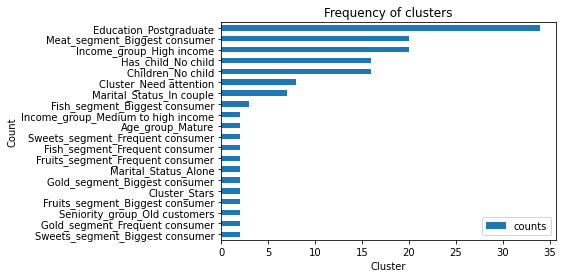

In [314]:
import matplotlib.pyplot as plt
wines_customers_traits = wines_customers_traits.sort_values(by='counts', ascending=True)
wines_customers_traits.plot(x='feature', y='counts', kind='barh',title='Frequency of clusters')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

In [312]:
wines_customers = data.iloc[data.index.isin(results_personnal_care.index)]
wines_customers.to_csv('wines_customers_data.csv')

In [313]:
wines_customers

,Age,Education,Marital_Status,Income,Spending,Seniority,Has_child,Children,Wines,Fruits,Meat,Fish,Sweets,Gold,Cluster,Age_group,Income_group,Seniority_group,Wines_segment,Fruits_segment,Meat_segment,Fish_segment,Sweets_segment,Gold_segment
28,25,Postgraduate,In couple,38360.000,131,16.367,Has child,1 child,36,2,42,20,21,10,High potential,Young,Low to medium income,Experienced customers,Frequent consumer,Low consumer,Frequent consumer,Frequent consumer,Frequent consumer,Low consumer
186,44,Postgraduate,Alone,32303.000,39,7.000,Has child,1 child,35,0,2,0,0,2,Leaky bucket,Adult,Low income,New customers,Frequent consumer,Non consumer,Low consumer,Non consumer,Non consumer,Low consumer
276,58,Postgraduate,Alone,60714.000,957,20.833,No child,No child,216,162,224,101,92,162,Need attention,Mature,Medium to high income,Experienced customers,Frequent consumer,Biggest consumer,Frequent consumer,Biggest consumer,Biggest consumer,Biggest consumer
414,52,Postgraduate,In couple,75072.000,1073,20.633,Has child,1 child,583,34,309,0,22,125,Need attention,Mature,High income,Experienced customers,Biggest consumer,Frequent consumer,Biggest consumer,Non consumer,Frequent consumer,Biggest consumer
441,66,Postgraduate,In couple,56223.000,156,9.600,Has child,1 child,77,28,31,16,0,4,Leaky bucket,Senior,Medium to high income,Discovering customers,Frequent consumer,Frequent consumer,Frequent consumer,Frequent consumer,Non consumer,Low consumer
492,59,Postgraduate,In couple,76005.000,1722,19.633,No child,No child,983,20,389,240,50,40,Need attention,Mature,High income,Experienced customers,Biggest consumer,Frequent consumer,Biggest consumer,Biggest consumer,Biggest consumer,Frequent consumer
518,55,Postgraduate,In couple,71367.000,777,13.567,No child,No child,227,23,389,42,21,75,Stars,Mature,High income,Discovering customers,Frequent consumer,Frequent consumer,Biggest consumer,Frequent consumer,Frequent consumer,Biggest consumer
562,43,Postgraduate,In couple,71499.000,795,15.533,Has child,1 child,465,25,132,136,0,37,Stars,Adult,High income,Experienced customers,Frequent consumer,Frequent consumer,Frequent consumer,Biggest consumer,Non consumer,Frequent consumer
606,41,Postgraduate,Alone,42429.000,67,7.833,Has child,1 child,55,0,6,2,0,4,Leaky bucket,Adult,Low to medium income,New customers,Frequent consumer,Non consumer,Low consumer,Low consumer,Non consumer,Low consumer
618,36,Postgraduate,Alone,54162.000,42,18.833,Has child,2 children,5,6,10,6,5,10,High potential,Adult,Medium to high income,Experienced customers,Low consumer,Frequent consumer,Low consumer,Low consumer,Frequent consumer,Low consumer


# Conclusion
So according to the output and overall analysis conducted on this data science project on customer personality analysis with Python, we can conclude that the biggest customers of wines are:

1. Customers with an average income of around $69,500.

2. Customers with an average total spend of approximately $1,252.
3. Customers registered with the company for approximately **21 months**.
4. Customers with a **graduate** degree.
5. And customers who are also heavy consumers of **meat** products.